In [1]:
#importing Python libraries
import pandas as pd
import numpy as np
import seaborn as sns
sns.set()
import matplotlib.pyplot as plt
import tabula

In [2]:
# Loading datasets
prod = pd.read_csv("AfricaFoodProduction.csv")
supply = pd.read_csv("AfricaFoodSupply.csv")

### African food production Data Exploration

In [3]:
prod.head(10)

,Country,Item,Year,Value
0,Algeria,Wheat and products,2004,2731
1,Algeria,Wheat and products,2005,2415
2,Algeria,Wheat and products,2006,2688
3,Algeria,Wheat and products,2007,2319
4,Algeria,Wheat and products,2008,1111
5,Algeria,Wheat and products,2009,2953
6,Algeria,Wheat and products,2010,2605
7,Algeria,Wheat and products,2011,2555
8,Algeria,Wheat and products,2012,3432
9,Algeria,Wheat and products,2013,3299


In [4]:
prod.describe(include='all')

,Country,Item,Year,Value
count,23110,23110,23110.000000,23110.000000
unique,45,94,NaN,NaN
top,United Republic of Tanzania,"Vegetables, Other",NaN,NaN
freq,790,450,NaN,NaN
mean,NaN,NaN,2008.498269,327.785201
std,NaN,NaN,2.871740,1607.940343
min,NaN,NaN,2004.000000,0.000000
25%,NaN,NaN,2006.000000,3.000000
50%,NaN,NaN,2008.000000,18.000000
75%,NaN,NaN,2011.000000,108.000000


In [5]:
#Checking datatype
prod.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23110 entries, 0 to 23109
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   Country  23110 non-null  object
 1   Item     23110 non-null  object
 2   Year     23110 non-null  int64 
 3   Value    23110 non-null  int64 
dtypes: int64(2), object(2)
memory usage: 722.3+ KB


In [6]:
#converting Year column to the right datatype and styling the data for better table visualization
prod['Year'] = pd.to_datetime(prod['Year'], format='%Y')
format_dict  = {'Year':'{:%Y}', 'Value':'{:}kt'}
prod.head().style.format(format_dict)

,Country,Item,Year,Value
0,Algeria,Wheat and products,2004,2731kt
1,Algeria,Wheat and products,2005,2415kt
2,Algeria,Wheat and products,2006,2688kt
3,Algeria,Wheat and products,2007,2319kt
4,Algeria,Wheat and products,2008,1111kt


In [19]:
prod['Year'] = prod['Year'].dt.year

In [7]:
prod.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23110 entries, 0 to 23109
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   Country  23110 non-null  object        
 1   Item     23110 non-null  object        
 2   Year     23110 non-null  datetime64[ns]
 3   Value    23110 non-null  int64         
dtypes: datetime64[ns](1), int64(1), object(2)
memory usage: 722.3+ KB


In [23]:
#checking number of countries in production data
len(set(prod['Country']))

45

In [24]:
#checking number of years under study
len(set(prod['Year']))

10

In [25]:
#checking number of food item categories under study
len(set(prod['Item']))

94

In [8]:
#grouping dataset by country, year, and item
pd.set_option('display.max_rows', None)
prod.groupby(['Country', 'Year', 'Item']).sum('Value')

Value
Country                     Year       Item                                  
Algeria                     2004-01-01 Apples and products                165
                                       Bananas                              0
                                       Barley and products               1212
                                       Beans                                2
                                       Beer                               110
                                       Beverages, Alcoholic                 0
                                       Bovine Meat                        125
                                       Butter, Ghee                         2
                                       Cephalopods                          1
                                       Cereals, Other                       0
                                       Citrus, Other                        0
                                       Cottonseed                           0
                                       Crustaceans                          3
                                       Dates                              443
                                       Demersal Fish                       10
                                       Eggs                               180
                                       Fats, Animals, Raw                   7
                                       Freshwater Fish                      1
                                       Fruits, Other                      480
                                       Grapefruit and products              2
                                       Grapes and products (excl wine)    284
                                       Groundnut Oil                       19
                                       Groundnuts (Shelled Eq)              3
                                       Honey                                3
                                       Lemons, Limes and products          46
                                       Maize and products                   1
                                       Marine Fish, Other                   0
                                       Meat, Other                         11
                                       Milk - Excluding Butter           1701
                                       Molluscs, Other                      0
                                       Mutton & Goat Meat                 185
                                       Nuts and products                   38
                                       Oats                                89
                                       Offals, Edible                      40
                                       Oilcrops Oil, Other                  2
                                       Olive Oil                           61
                                       Olives (including preserved)       469
                                       Onions                             658
                                       Oranges, Mandarines                561
                                       Peas                                 7
                                       Pelagic Fish                       100
                                       Pigmeat                              0
                                       Pimento                              6
                                       Potatoes and products             1896
                                       Poultry Meat                       268
                                       Pulses, Other and products          49
                                       Rape and Mustard Oil                 9
                                       Rape and Mustardseed                29
                                       Rice (Milled Equivalent)             0
                                       Sorghum and products                 1
                

In [9]:
#grouping dataset by country and year to get the total food produced per year, per country
prod.groupby(['Country', 'Year']).sum()


Value
Country                     Year              
Algeria                     2004-01-01   15536
                            2005-01-01   15667
                            2006-01-01   16417
                            2007-01-01   14763
                            2008-01-01   13841
                            2009-01-01   19820
                            2010-01-01   20263
                            2011-01-01   21778
                            2012-01-01   24206
                            2013-01-01   26359
Angola                      2004-01-01   13028
                            2005-01-01   13811
                            2006-01-01   14264
                            2007-01-01   16025
                            2008-01-01   17288
                            2009-01-01   22244
                            2010-01-01   23805
                            2011-01-01   25672
                            2012-01-01   20505
                            2013-01-01   28857
Benin                       2004-01-01    7963
                            2005-01-01    7764
                            2006-01-01    7110
                            2007-01-01    7679
                            2008-01-01    8723
                            2009-01-01    9235
                            2010-01-01    9200
                            2011-01-01    9735
                            2012-01-01    9797
                            2013-01-01   10866
Botswana                    2004-01-01     461
                            2005-01-01     460
                            2006-01-01     454
                            2007-01-01     439
                            2008-01-01     470
                            2009-01-01     484
                            2010-01-01     503
                            2011-01-01     539
                            2012-01-01     496
                            2013-01-01     502
Burkina Faso                2004-01-01    8323
                            2005-01-01    9392
                            2006-01-01    9393
                            2007-01-01    8467
                            2008-01-01   10373
                            2009-01-01    9607
                            2010-01-01   11122
                            2011-01-01    9954
                            2012-01-01   11634
                            2013-01-01   11864
Cabo Verde                  2004-01-01     148
                            2005-01-01     156
                            2006-01-01     158
                            2007-01-01     157
                            2008-01-01     172
                            2009-01-01     158
                            2010-01-01     149
                            2011-01-01     181
                            2012-01-01     187
                            2013-01-01     192
Cameroon                    2004-01-01   13739
                            2005-01-01   16033
                            2006-01-01   16962
                            2007-01-01   17657
                            2008-01-01   18459
                            2009-01-01   20729
                            2010-01-01   22310
                            2011-01-01   22964
                            2012-01-01   24044
                            2013-01-01   24773
Central African Republic    2004-01-01    2242
                            2005-01-01    2293
                            2006-01-01    2329
                            2007-01-01    2426
                            2008-01-01    2494
                            2009-01-01    2569
                            2010-01-01    2602
                            2011-01-01    2702
                            2012-01-01    2761
                            2013-01-01    2503
Chad                        2004-01-01    3660
                            2005-01-01    4360
                            2006-01-01    4423
                            2007-01-01    4243

In [10]:
#confirming that there are no missing value
prod.isnull().sum()

Country    0
Item       0
Year       0
Value      0
dtype: int64

In [26]:
#matplotx should help with better visualization in matplotlib
pip install matplotx[all]

Note: you may need to restart the kernel to use updated packages.


In [11]:
import matplotx

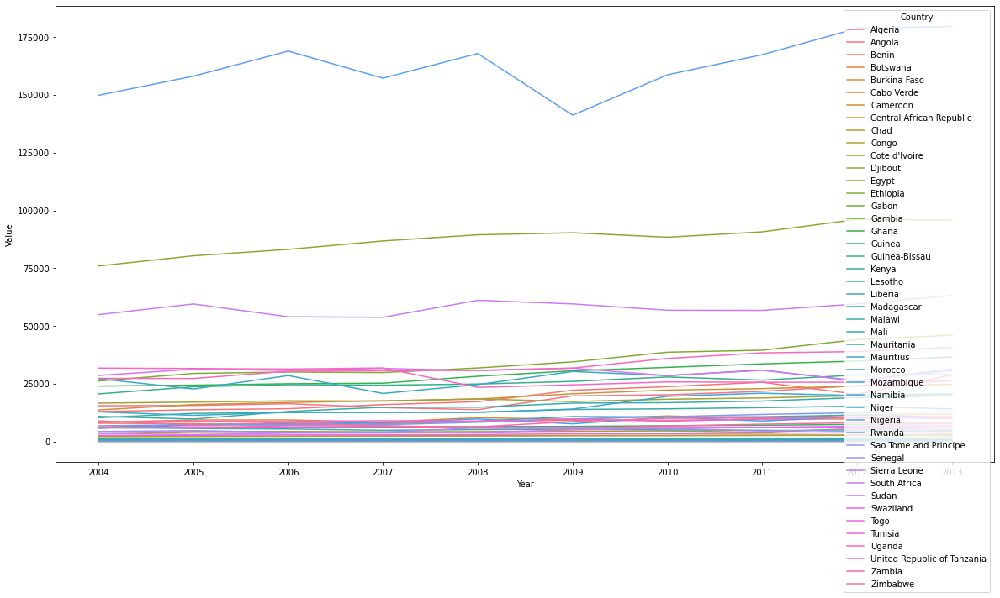

In [11]:
%matplotlib inline
plt.figure(figsize=(20,10))
data = prod.groupby(['Country', 'Year']).sum()
sns.lineplot(x='Year', y='Value', hue='Country', data=data, legend = 'full')
plt.show()

Visualization isn't clear enough. Legend labelling not as direct as needed.

In [12]:
#alternative to failed matplotx
import plotly.express as px

In [13]:
fig = px.line(prod, x='Year', y="Value", title='Food Production Rates by Year and Country', color='Country')
fig.show()

Visualization still isn't clear, but countries with highest production rate is notable with the hover function and interactive visuals.
The top 3 countries in descending order in colurs red, pink, and green, are Nigeria, Egypt and South Africa.

In [14]:
#Different attempt at max and min visualization
prod.style.format(format_dict).highlight_max(color='darkgreen').highlight_min(color='blue')

,Country,Item,Year,Value
0,Algeria,Wheat and products,2004,2731kt
1,Algeria,Wheat and products,2005,2415kt
2,Algeria,Wheat and products,2006,2688kt
3,Algeria,Wheat and products,2007,2319kt
4,Algeria,Wheat and products,2008,1111kt
5,Algeria,Wheat and products,2009,2953kt
6,Algeria,Wheat and products,2010,2605kt
7,Algeria,Wheat and products,2011,2555kt
8,Algeria,Wheat and products,2012,3432kt
9,Algeria,Wheat and products,2013,3299kt


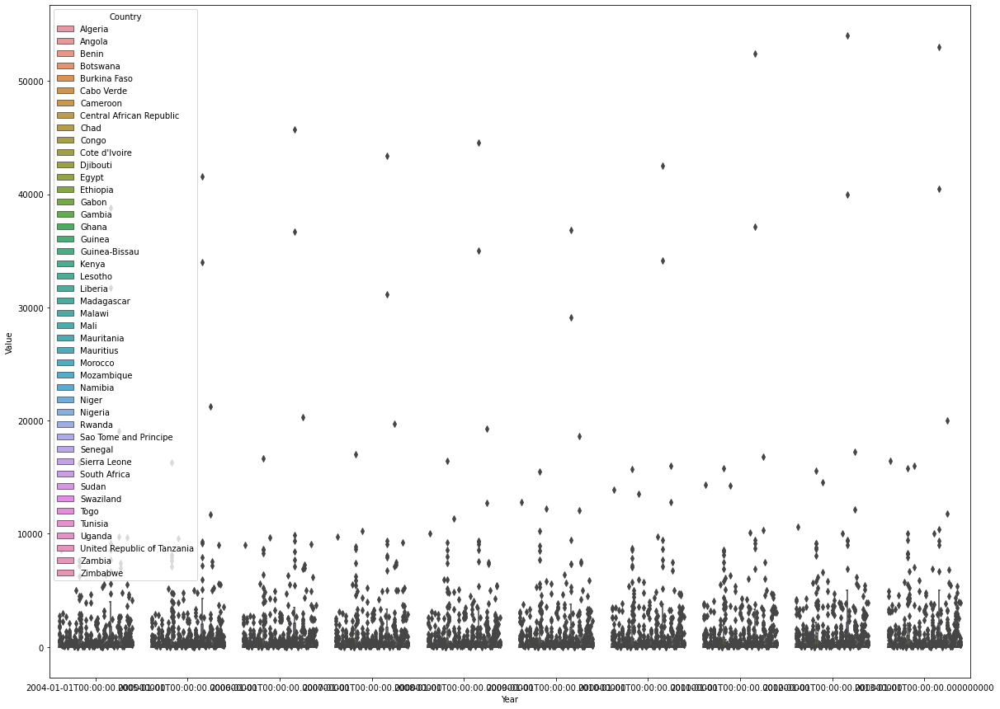

In [15]:
plt.figure(figsize=(20,15))
sns.boxplot(x='Year', y='Value', data=prod, hue='Country')
plt.show()

Still not good enough

In [16]:
#creating a new dataset with the top 3 countries in production
ls = ['Nigeria', 'Egypt', 'South Africa']
data.loc[ls]

Value
Country      Year              
Nigeria      2004-01-01  149857
             2005-01-01  158149
             2006-01-01  168987
             2007-01-01  157273
             2008-01-01  167935
             2009-01-01  141270
             2010-01-01  158709
             2011-01-01  167403
             2012-01-01  178816
             2013-01-01  179631
Egypt        2004-01-01   75989
             2005-01-01   80422
             2006-01-01   83191
             2007-01-01   86828
             2008-01-01   89489
             2009-01-01   90375
             2010-01-01   88450
             2011-01-01   90767
             2012-01-01   96139
             2013-01-01   95848
South Africa 2004-01-01   54949
             2005-01-01   59577
             2006-01-01   54024
             2007-01-01   53795
             2008-01-01   61162
             2009-01-01   59590
             2010-01-01   56863
             2011-01-01   56788
             2012-01-01   59581
             2013-01-01   63263

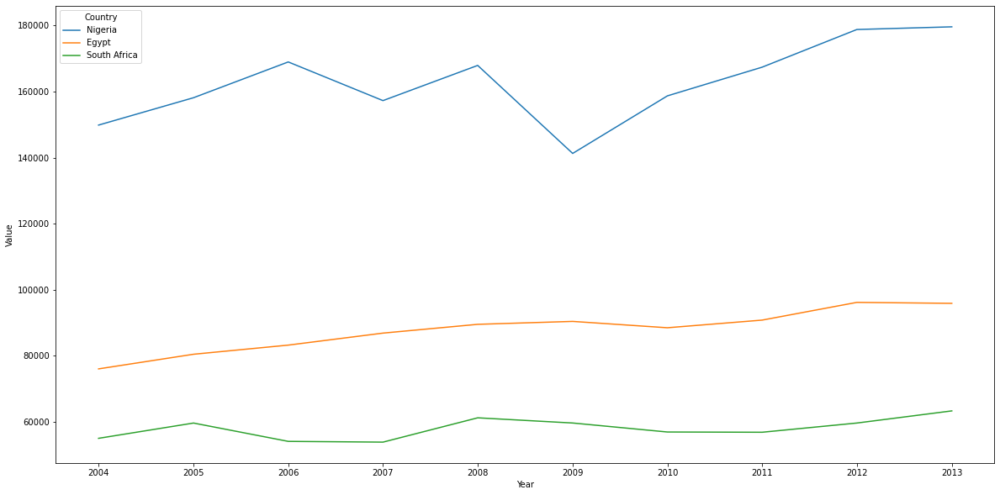

In [18]:
#visualizing top 3 data

%matplotlib inline
plt.figure(figsize=(20,10))
top3 = data.loc[ls]
sns.lineplot(x='Year', y='Value', hue='Country', data=top3, legend = 'full')
plt.show()

This gives a clearer idea of the food production in selected countries. If the country with the third highest production barely manages to produce up to 70000kt, what happens to the lowest 3?

In [39]:

top3.reset_index(inplace=True)
top3.head()

,Country,Year,Value
0,Nigeria,2004-01-01,149857
1,Nigeria,2005-01-01,158149
2,Nigeria,2006-01-01,168987
3,Nigeria,2007-01-01,157273
4,Nigeria,2008-01-01,167935


In [40]:
fig = px.line(top3, x='Year', y="Value", title='Food Production Rates by Year and Country', color='Country')
fig.show()

### Exploring African food supply data

In [22]:
supply.head()

,Country,Year,Value
0,Algeria,2004,2987
1,Algeria,2005,2958
2,Algeria,2006,3047
3,Algeria,2007,3041
4,Algeria,2008,3048


In [27]:
#Number of countries in the dataset
len(set(supply['Country']))
#similar to that present in the production data

45

In [28]:
#Years covered in the supply dataset
len(set(supply['Year']))
#10 years covered

10

In [29]:
#checking datatype
supply.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 450 entries, 0 to 449
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   Country  450 non-null    object
 1   Year     450 non-null    int64 
 2   Value    450 non-null    int64 
dtypes: int64(2), object(1)
memory usage: 10.7+ KB


In [30]:
#converting year column to datetime
supply['Year'] = pd.to_datetime(supply['Year'], format='%Y')
supply.head()

,Country,Year,Value
0,Algeria,2004-01-01,2987
1,Algeria,2005-01-01,2958
2,Algeria,2006-01-01,3047
3,Algeria,2007-01-01,3041
4,Algeria,2008-01-01,3048


In [31]:
supply.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 450 entries, 0 to 449
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   Country  450 non-null    object        
 1   Year     450 non-null    datetime64[ns]
 2   Value    450 non-null    int64         
dtypes: datetime64[ns](1), int64(1), object(1)
memory usage: 10.7+ KB


In [32]:
#adding style to dataset
format_dict  = {'Year':'{:%Y}', 'Value':'{:}kcal/person/day'}
supply.head().style.format(format_dict)

,Country,Year,Value
0,Algeria,2004,2987kcal/person/day
1,Algeria,2005,2958kcal/person/day
2,Algeria,2006,3047kcal/person/day
3,Algeria,2007,3041kcal/person/day
4,Algeria,2008,3048kcal/person/day


In [33]:
supply.groupby(['Country', 'Year']).sum()

Value
Country                     Year             
Algeria                     2004-01-01   2987
                            2005-01-01   2958
                            2006-01-01   3047
                            2007-01-01   3041
                            2008-01-01   3048
                            2009-01-01   3110
                            2010-01-01   3142
                            2011-01-01   3217
                            2012-01-01   3272
                            2013-01-01   3296
Angola                      2004-01-01   2030
                            2005-01-01   2077
                            2006-01-01   2119
                            2007-01-01   2173
                            2008-01-01   2245
                            2009-01-01   2303
                            2010-01-01   2345
                            2011-01-01   2407
                            2012-01-01   2384
                            2013-01-01   2473
Benin                       2004-01-01   2461
                            2005-01-01   2435
                            2006-01-01   2450
                            2007-01-01   2564
                            2008-01-01   2521
                            2009-01-01   2565
                            2010-01-01   2555
                            2011-01-01   2598
                            2012-01-01   2610
                            2013-01-01   2619
Botswana                    2004-01-01   2191
                            2005-01-01   2198
                            2006-01-01   2150
                            2007-01-01   2166
                            2008-01-01   2184
                            2009-01-01   2199
                            2010-01-01   2234
                            2011-01-01   2273
                            2012-01-01   2342
                            2013-01-01   2326
Burkina Faso                2004-01-01   2505
                            2005-01-01   2463
                            2006-01-01   2559
                            2007-01-01   2546
                            2008-01-01   2588
                            2009-01-01   2639
                            2010-01-01   2681
                            2011-01-01   2664
                            2012-01-01   2707
                            2013-01-01   2720
Cabo Verde                  2004-01-01   2523
                            2005-01-01   2517
                            2006-01-01   2513
                            2007-01-01   2574
                            2008-01-01   2540
                            2009-01-01   2558
                            2010-01-01   2524
                            2011-01-01   2566
                            2012-01-01   2590
                            2013-01-01   2609
Cameroon                    2004-01-01   2246
                            2005-01-01   2311
                            2006-01-01   2354
                            2007-01-01   2378
                            2008-01-01   2446
                            2009-01-01   2492
                            2010-01-01   2510
                            2011-01-01   2573
                            2012-01-01   2622
                            2013-01-01   2671
Central African Republic    2004-01-01   1989
                            2005-01-01   2026
                            2006-01-01   2029
                            2007-01-01   2090
                            2008-01-01   2133
                            2009-01-01   2139
                            2010-01-01   2164
                            2011-01-01   2154
                            2012-01-01   2116
                            2013-01-01   1879
Chad                        2004-01-01   2026
                            2005-01-01   2034
                            2006-01-01   2022
                            2007-01-01   2028
                            2008-01-01   2027
                            2009-01-01

In [34]:
#visualizing
fig = px.line(supply, x='Year', y="Value", title='Food Supply Rates by Year and Country', color='Country')
fig.show()

Data visualization show that Egypt, Tunisia, and Morrocco have been leading for about 10 years in terms of food supply/consumption.

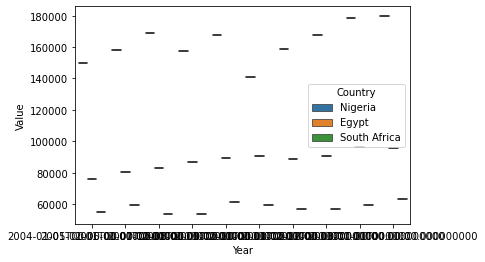

In [42]:
%matplotlib inline
sns.boxplot(x='Year', y='Value', data=top3, hue='Country')
plt.show()

### Data manipulation
Null hypothesis (H0): food production = food supply  
Alternative hypothesis (H1): food production != food supply

In [47]:
#merging food production and supply datasets
data = prod.groupby(['Country', 'Year']).sum()
data.reset_index(inplace=True)
data.head()

,Country,Year,Value
0,Algeria,2004-01-01,15536
1,Algeria,2005-01-01,15667
2,Algeria,2006-01-01,16417
3,Algeria,2007-01-01,14763
4,Algeria,2008-01-01,13841


In [48]:
supply.head()

,Country,Year,Value
0,Algeria,2004-01-01,2987
1,Algeria,2005-01-01,2958
2,Algeria,2006-01-01,3047
3,Algeria,2007-01-01,3041
4,Algeria,2008-01-01,3048


In [49]:
merge = pd.merge(data, supply, on=['Country', 'Year'], suffixes=('_prod', '_sup'))
merge.head()

,Country,Year,Value_prod,Value_sup
0,Algeria,2004-01-01,15536,2987
1,Algeria,2005-01-01,15667,2958
2,Algeria,2006-01-01,16417,3047
3,Algeria,2007-01-01,14763,3041
4,Algeria,2008-01-01,13841,3048


In [50]:
merge.describe()

,Value_prod,Value_sup
count,450.000000,450.000000
mean,16833.591111,2469.775556
std,27707.501219,379.140143
min,55.000000,1781.000000
25%,2299.250000,2174.000000
50%,7884.500000,2376.000000
75%,20712.750000,2681.750000
max,179631.000000,3561.000000


In [62]:
#grouping data by country and year
grouped = merge.groupby(['Country', 'Year']).sum()
#selecting 3 top countries in production and supply based on displayed visuals
count = ['Nigeria', 'Egypt', 'South Africa', 'Tunisia', 'Morocco']
df = grouped.loc[count]
df.head()

Value_prod  Value_sup
Country Year                             
Nigeria 2004-01-01      149857       2655
        2005-01-01      158149       2705
        2006-01-01      168987       2725
        2007-01-01      157273       2720
        2008-01-01      167935       2723

<AxesSubplot:label='5c717fe4-2cb3-4ead-9880-6eccedb87ea3'>

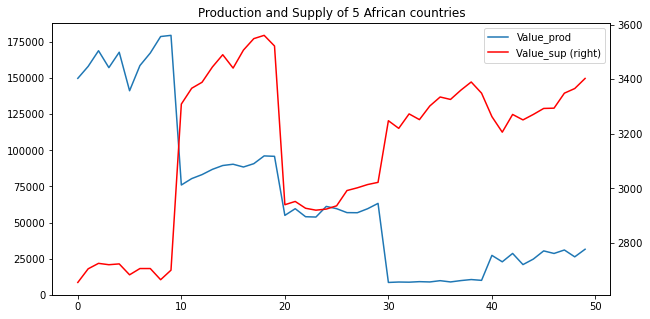

In [63]:
#exploring the relationship between production and supply
df.reset_index(inplace=True)
df.set_index('Country')
ax = df[['Value_prod']].plot()
df[['Value_sup']].plot(style='r', ax=ax, secondary_y=True, figsize=(10, 5), title='Production and Supply of 5 African countries')

* Key  
On X-axis:  
0-9 represents Nigeria  
10-19 represents Egypt  
20-29 represent South Africa  
30-39 represent Tunisia  
40-49 represent Morocco  
On Y-axis:  
Left represents Production  
Right reprents Supply  

The graph above shows that there's little relationship between the rate of food production and the rate of supply or consumption. Only South Africa appears to match its production with consumption.

### Conclusion
Data shows that food production does not determine supply or consumption.  
Other factors like climate, national security, economic stability, and of course, population may have more impact than production.